In [1]:
using DifferentialEquations
using Plots

### In order for an echo state network to function properly, the transient solution must eventually disappear

In [2]:
struct TransientParams
    A
    f
    γ
    ρ
end;

In [3]:
function echo_state!(dr, r, p::TransientParams, t)
    dr[:] = p.γ.*(-r + p.f.(p.ρ.*p.A*r));
end;

In [86]:
r₀ = 2*(rand(Float64, 20).-0.5);
my_params = TransientParams(
    2*(rand(Float64, (20,20)).-0.5), 
    tanh, 
    0.3, 
    0.4)
prob = ODEProblem(echo_state!, r₀, (-100.0,0.0), my_params);
sol = solve(prob);

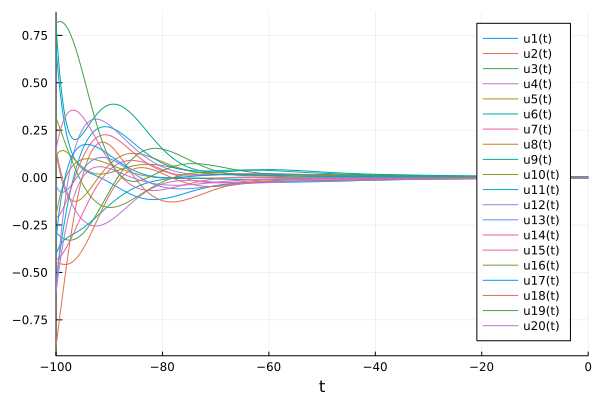

In [87]:
plot(sol)

### We wish to approximate $d(t)$

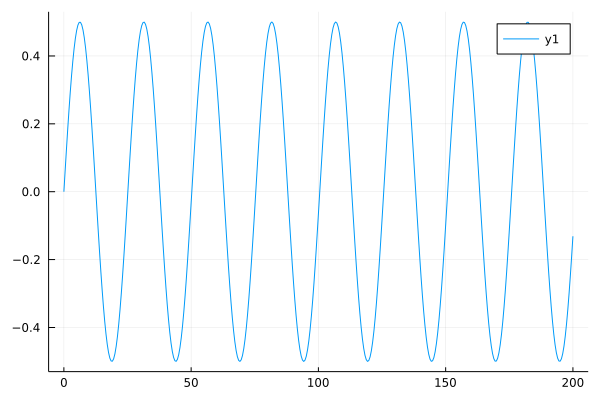

In [29]:
t = LinRange(0, 200, 400);
d(x) = 0.5*sin(x/4);
plot(t, d.(t))

### We will now drive the ESN with the input

In [30]:
struct DriveParams
    Wᵢₙ
    u
    A
    f
    γ
    σ
    ρ
end;

In [31]:
function drive_echo_state!(dr, r, p::DriveParams, t)
    dr[:] = p.γ.*(-r + p.f.(p.ρ.*p.A*r + p.σ*p.Wᵢₙ*p.u(t)));
end;

In [88]:
drive_params = DriveParams(
    2*(rand(Float64, (20,1)).-0.5),
    d,
    my_params.A,
    my_params.f, 
    my_params.γ,
    0.3, 
    my_params.ρ);

In [89]:
drive_prob = ODEProblem(drive_echo_state!, r₀, (-100.0,200.0), drive_params);
drive_sol = solve(drive_prob);

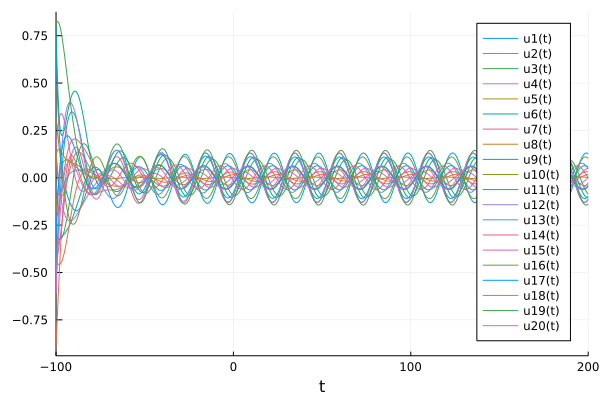

In [90]:
plot(drive_sol)

### We will now calculate $W_{out}$

In [91]:
D = d.(t[t .> 0]);
R =  hcat(sol.(t[t .> 0])...);

A R = D'
1 x 20 20 x 400  = 1 x 400
R' A' = D
R R' A' = R D

In [92]:
Wₒᵤₜ = (R*R' \ R*D)';

In [93]:
sum(Wₒᵤₜ * R - D')

0.0006498454846625146

We will now make the reservoir computer drive itself

In [94]:
struct TrainParams
    Wₒᵤₜ
    Wᵢₙ
    u
    A
    f
    γ
    σ
    ρ
end;

In [95]:
function train_echo_state!(dr, r, params::TrainParams, t)
    dr[:] = params.γ.*(-r + params.f.(params.ρ.*params.A*r + params.σ*params.Wᵢₙ*params.Wₒᵤₜ*r));
end;

In [96]:
train_params = TrainParams(
    Wₒᵤₜ,
    drive_params.Wᵢₙ,
    drive_params.u,
    drive_params.A,
    drive_params.f,
    drive_params.γ,
    drive_params.σ,
    drive_params.ρ);

In [97]:
train_prob = ODEProblem(train_echo_state!, drive_sol.u[end], (200,400.0), train_params);
train_sol = solve(train_prob);

In [98]:
plot(train_sol)

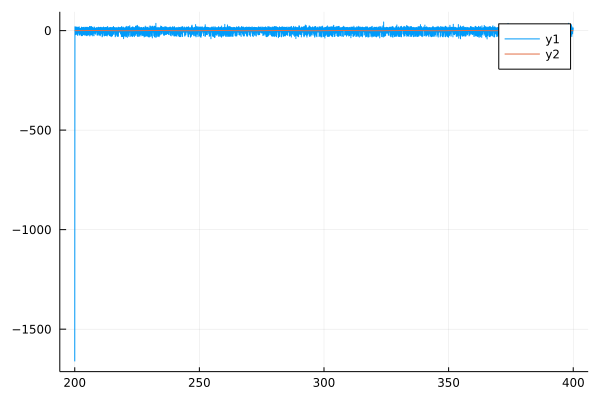

In [99]:
plot(train_sol.t, (Wₒᵤₜ*hcat(train_sol.u...))')
plot!(train_sol.t, d.(train_sol.t))